# Pre-processing and Feature Development

Now that the data has been cleaned and transformed, the next steps are to build the geometric features used for classification.

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.spatial import cKDTree

In [2]:
file_name = 'data/df_processed.csv'
df = pd.read_csv(file_name)

In [3]:
df

,Intensity,Original_cloud_index,PCV,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,axial_inch_round,vertical_inch_round,is_rail_a,is_rail_b,relative_vertical_inch,relative_lateral_inch,is_synth
0,4,0,0.648305,30.969601,73.969852,0.207422,371.635216,887.638218,2.489062,371.6250,887.6250,2.5000,0,1,-1.636106,0.358831,NaN
1,8,0,0.533898,30.971278,72.980139,0.114840,371.655341,875.761669,1.378078,371.6250,875.7500,1.3750,0,1,-2.724316,0.387008,NaN
2,6,0,0.504237,30.984129,73.394396,0.174534,371.809543,880.732753,2.094413,371.8125,880.7500,2.1250,0,1,-2.016024,0.541040,NaN
3,11,0,0.572034,30.983353,73.987505,0.076702,371.800232,887.850054,0.920427,371.8125,887.8750,0.9375,0,1,-3.205152,0.523372,NaN
4,12,0,0.885593,30.902538,73.039362,0.325916,370.830450,876.472344,3.910989,370.8125,876.5000,3.9375,0,1,-0.192049,-0.437883,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
769209,3,2,0.889831,-44.816390,101.593367,0.526926,-537.796676,1225.120403,6.323110,-537.8125,1219.1250,6.3125,1,0,-0.281820,-1.043377,1.0
769210,7,2,0.957627,-44.818952,102.850671,0.520461,-537.827426,1240.208056,6.245534,-537.8125,1234.1875,6.2500,1,0,-0.330203,-0.944458,1.0
769211,8,2,0.906780,-44.825701,101.852361,0.523527,-537.908414,1228.228330,6.282330,-537.9375,1222.2500,6.3125,1,0,-0.322600,-1.151885,1.0
769212,1,2,0.911017,-44.799569,101.856541,0.520309,-537.594827,1228.278491,6.243713,-537.6250,1222.2500,6.2500,1,0,-0.361216,-0.838298,1.0


In [4]:
# GOAL
'''
Eigenvectors and Eigenvalues

Geometric features for clustering

'''

'\nEigenvectors and Eigenvalues\n\nGeometric features for clustering\n\n'

These features are based on the list of features that can be created in Cloudcompare.<br><br>
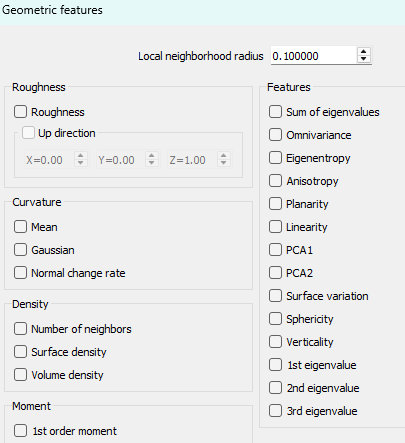

In [5]:
def _pca_cov(points):
    if points.shape[0] < 3:
        return None, None, None, None
    mu = points.mean(axis=0)
    X = points - mu
    C = (X.T @ X) / max(len(points), 1)          # covariance (scale factor cancels if we normalize eigs)
    evals, evecs = np.linalg.eigh(C)             # ascending
    order = np.argsort(evals)[::-1]              # sort to λ1≥λ2≥λ3
    evals = evals[order]
    evecs = evecs[:, order]                      # columns are e1,e2,e3
    return mu, C, evals, evecs

def _first_order_moment(points, mu, n):
    if points is None or mu is None or n is None:
        return np.nan
    return np.abs((points - mu) @ n).mean()      # mean absolute point-to-plane distance

def compute_features_for_df(
    df: pd.DataFrame,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    radius: float | None = None,
    k_neighbors: int | None = None,
    normalize_eigs: bool = True,      # if True, λ1+λ2+λ3 = 1 (scale-invariant)
    up_vector=(0.0, 0.0, 1.0),
    include_normals: bool = True,
    orient_normals_to_up: bool = True,
    eps: float = 1e-12
) -> pd.DataFrame:
    assert (radius is None) ^ (k_neighbors is None), "Specify exactly one of radius or k_neighbors"

    xyz = df[[x_col, y_col, z_col]].to_numpy(dtype=np.float64)
    N = xyz.shape[0]
    tree = cKDTree(xyz)

    # Precompute neighbors (vectorized KD query is faster)
    if radius is not None:
        # Variable-size neighborhoods; we’ll query per-point
        neighbor_lists = None
    else:
        dists, idxs = tree.query(xyz, k=k_neighbors)   # shape: (N, k)
        neighbor_lists = idxs

    up = np.asarray(up_vector, dtype=float)
    up = up / (np.linalg.norm(up) + eps)

    # Allocate arrays
    lam1 = np.full(N, np.nan); lam2 = np.full(N, np.nan); lam3 = np.full(N, np.nan)
    ev1x = np.full(N, np.nan); ev1y = np.full(N, np.nan); ev1z = np.full(N, np.nan)
    ev2x = np.full(N, np.nan); ev2y = np.full(N, np.nan); ev2z = np.full(N, np.nan)
    ev3x = np.full(N, np.nan); ev3y = np.full(N, np.nan); ev3z = np.full(N, np.nan)

    eigen_sum       = np.full(N, np.nan)
    omnivariance    = np.full(N, np.nan)
    eigenentropy    = np.full(N, np.nan)
    anisotropy      = np.full(N, np.nan)
    planarity       = np.full(N, np.nan)
    linearity       = np.full(N, np.nan)
    surface_var     = np.full(N, np.nan)
    sphericity      = np.full(N, np.nan)
    pca1            = np.full(N, np.nan)
    pca2            = np.full(N, np.nan)
    verticality     = np.full(N, np.nan)
    O_moment        = np.full(N, np.nan)
    n_count         = np.zeros(N, dtype=int)

    if include_normals:
        Nx = np.full(N, np.nan); Ny = np.full(N, np.nan); Nz = np.full(N, np.nan)

    # Iterate points
    for i in range(N):
        if radius is None:
            idx = neighbor_lists[i]
        else:
            idx = tree.query_ball_point(xyz[i], r=radius)
        P = xyz[idx]
        n_count[i] = len(P)
        if len(P) < 3:
            continue

        mu, C, evals, evecs = _pca_cov(P)
        if evals is None:
            continue

        # Raw eigenvalues
        L1, L2, L3 = evals
        S = max(L1 + L2 + L3, eps)

        if normalize_eigs:
            l1, l2, l3 = L1/S, L2/S, L3/S
        else:
            l1, l2, l3 = L1, L2, L3

        e1, e2, e3 = evecs[:,0], evecs[:,1], evecs[:,2]

        # Store eigenvalues (normalized or raw depending on flag)
        lam1[i], lam2[i], lam3[i] = l1, l2, l3

        # Store eigenvectors
        ev1x[i], ev1y[i], ev1z[i] = e1
        ev2x[i], ev2y[i], ev2z[i] = e2
        ev3x[i], ev3y[i], ev3z[i] = e3

        # Feature set (CloudCompare / Hackel et al.)
        eigen_sum[i]    = S if not normalize_eigs else (L1 + L2 + L3)    # raw trace as scale proxy
        omnivariance[i] = max(l1*l2*l3, 0.0) ** (1.0/3.0)
        e1c, e2c, e3c   = max(l1, eps), max(l2, eps), max(l3, eps)
        eigenentropy[i] = -(e1c*np.log(e1c) + e2c*np.log(e2c) + e3c*np.log(e3c))
        anisotropy[i]   = (l1 - l3) / (l1 + eps)
        planarity[i]    = (l2 - l3) / (l1 + eps)
        linearity[i]    = (l1 - l2) / (l1 + eps)
        surface_var[i]  = l3 / (l1 + l2 + l3 + eps)
        sphericity[i]   = l3 / (l1 + eps)
        denom           = (l1 + l2 + l3 + eps)
        pca1[i]         = l1 / denom
        pca2[i]         = l2 / denom

        # Verticality: 1 - |<up, e3>|
        v = 1.0 - abs(float(np.dot(up, e3)))
        verticality[i] = v

        # First-order moment O: mean |point-to-plane| using e3, plane through μ
        O_moment[i] = _first_order_moment(P, mu, e3)

        # Optional normal export (use e3, smallest-eigenvalue dir). Optionally orient to up.
        if include_normals:
            nvec = e3.copy()
            if orient_normals_to_up and np.dot(nvec, up) < 0:
                nvec = -nvec
            Nx[i], Ny[i], Nz[i] = nvec

    # Assemble DataFrame with consistent column names
    feat = pd.DataFrame({
        'lam1': lam1, 'lam2': lam2, 'lam3': lam3,
        'e1x': ev1x, 'e1y': ev1y, 'e1z': ev1z,
        'e2x': ev2x, 'e2y': ev2y, 'e2z': ev2z,
        'e3x': ev3x, 'e3y': ev3y, 'e3z': ev3z,
        'eigen_sum': eigen_sum,
        'omnivariance': omnivariance,
        'eigenentropy': eigenentropy,
        'anisotropy': anisotropy,
        'planarity': planarity,
        'linearity': linearity,
        'surface_variation': surface_var,
        'sphericity': sphericity,
        'pca1': pca1,
        'pca2': pca2,
        'verticality': verticality,
        'O': O_moment,
        'neighbors': n_count
    }, index=df.index)

    if include_normals:
        feat[['Nx', 'Ny', 'Nz']] = np.column_stack([Nx, Ny, Nz])

    return pd.concat([df, feat], axis=1)


In [6]:
df = compute_features_for_df(
     df,
     x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
     radius=1.0,
     normalize_eigs=True,
     k_neighbors=None,
     up_vector=(0,0,1),
     include_normals=True,
     orient_normals_to_up=True
 )

df

,Intensity,Original_cloud_index,PCV,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,...,surface_variation,sphericity,pca1,pca2,verticality,O,neighbors,Nx,Ny,Nz
0,4,0,0.648305,30.969601,73.969852,0.207422,371.635216,887.638218,2.489062,371.6250,...,0.026852,0.042416,0.633079,0.340069,0.455967,0.095123,55,0.836756,0.062184,0.544033
1,8,0,0.533898,30.971278,72.980139,0.114840,371.655341,875.761669,1.378078,371.6250,...,0.029050,0.056281,0.516153,0.454798,0.970787,0.096069,86,0.999446,0.015927,0.029213
2,6,0,0.504237,30.984129,73.394396,0.174534,371.809543,880.732753,2.094413,371.8125,...,0.037013,0.071978,0.514223,0.448765,0.598896,0.101047,53,0.915062,-0.042170,0.401104
3,11,0,0.572034,30.983353,73.987505,0.076702,371.800232,887.850054,0.920427,371.8125,...,0.038069,0.071079,0.535582,0.426350,0.981360,0.097120,75,0.999690,-0.016482,0.018640
4,12,0,0.885593,30.902538,73.039362,0.325916,370.830450,876.472344,3.910989,370.8125,...,0.056048,0.086856,0.645297,0.298655,0.675716,0.098035,41,-0.945948,0.004648,0.324284
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
769209,3,2,0.889831,-44.816390,101.593367,0.526926,-537.796676,1225.120403,6.323110,-537.8125,...,0.033191,0.056943,0.582881,0.383928,0.000453,0.092875,152,0.029186,0.007294,0.999547
769210,7,2,0.957627,-44.818952,102.850671,0.520461,-537.827426,1240.208056,6.245534,-537.8125,...,0.029967,0.041811,0.716726,0.253307,0.004308,0.084849,32,0.092715,0.001010,0.995692
769211,8,2,0.906780,-44.825701,101.852361,0.523527,-537.908414,1228.228330,6.282330,-537.9375,...,0.041959,0.062213,0.674437,0.283605,0.001181,0.099862,131,0.048151,-0.006441,0.998819
769212,1,2,0.911017,-44.799569,101.856541,0.520309,-537.594827,1228.278491,6.243713,-537.6250,...,0.039341,0.061433,0.640395,0.320263,0.006414,0.101129,145,0.113044,0.002888,0.993586


Additionally features are to follow:

PCV (Portion de Ciel Visible) in CloudCompare estimates how much of the sky is visible from each point in a 3D model. It works by simulating rays cast upward from each point to detect obstructions, helping assess sunlight exposure or shading..<br><br>
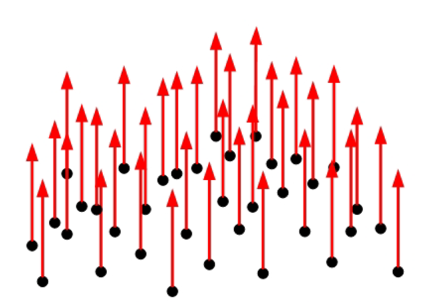

In [7]:
def fibonacci_hemisphere(n_dirs=256, seed=None):
    """Global +Z hemisphere directions (Fibonacci/golden-angle)."""
    rng = np.random.default_rng(seed)
    ga = np.pi * (3.0 - np.sqrt(5.0))
    k  = np.arange(n_dirs, dtype=float)
    z  = 1.0 - 2.0 * (k + 0.5) / n_dirs
    r  = np.sqrt(np.clip(1.0 - z*z, 0, 1))
    phi = k * ga
    dirs = np.column_stack([r * np.cos(phi), r * np.sin(phi), z])
    dirs = dirs[dirs[:, 2] >= 0.0]  # keep global +Z hemisphere
    # normalize numerically
    dirs /= (np.linalg.norm(dirs, axis=1, keepdims=True) + 1e-12)
    return dirs  # (M,3)

def compute_pcv_global_sky(
    df: pd.DataFrame,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    rays=256,
    r_max=24.0,                # try 24-60 inches to start, depending on scene scale
    cone_half_angle_deg=4.0,
    jitter=True,               # rotate directions slightly around +Z per point to avoid banding
    jitter_deg=3.0,            # +/-deg random azimuthal rotation
    write_col='Illuminance_(PCV)',
    verbose=True
) -> pd.DataFrame:
    xyz = df[[x_col, y_col, z_col]].to_numpy(np.float64)
    N   = xyz.shape[0]
    tree = cKDTree(xyz)

    base_dirs = fibonacci_hemisphere(rays)       # (M,3) global +Z hemisphere
    M = base_dirs.shape[0]
    cos_thr = np.cos(np.deg2rad(cone_half_angle_deg))

    pcv = np.zeros(N, dtype=np.float32)

    # Optional: precompute a set of rotated direction tables if jitter is on
    if jitter:
        def rot_z(theta):
            c, s = np.cos(theta), np.sin(theta)
            R = np.array([[c, -s, 0.0],
                          [s,  c, 0.0],
                          [0.0, 0.0, 1.0]])
            return R
        # create a few random rotations to reuse (faster)
        rng = np.random.default_rng(42)
        jitter_set = [rot_z(np.deg2rad(rng.uniform(-jitter_deg, jitter_deg))) for _ in range(8)]
    else:
        jitter_set = [np.eye(3)]

    for i in range(N):
        p = xyz[i]
        idx = tree.query_ball_point(p, r=r_max)
        if len(idx) <= 1:
            pcv[i] = 1.0
            continue

        neigh = xyz[idx]
        v = neigh - p
        d = np.linalg.norm(v, axis=1)
        mask = d > 1e-9
        if not np.any(mask):
            pcv[i] = 1.0
            continue
        vdir = (v[mask].T / (d[mask] + 1e-12)).T  # unit vectors to neighbors

        # pick one small random rotation around Z for this point
        R = jitter_set[i % len(jitter_set)]
        dirs = base_dirs @ R.T if jitter else base_dirs

        visible = 0
        for d_world in dirs:
            proj = vdir @ d_world   # cos(angle) to neighbors
            # occluded if any neighbor is inside cone and in front (proj>0)
            occluded = np.any((proj >= cos_thr) & (proj > 0.0))
            if not occluded:
                visible += 1
        pcv[i] = visible / M

        if verbose and (i % max(N//10, 1) == 0):
            print(f"PCV progress: {i}/{N} ({100*i/N:.1f}%)")

    out = df.copy()
    out[write_col] = pcv
    return out

In [8]:
'''
df = compute_pcv_global_sky(
    df,
    rays=512,
    r_max=36.0,               # start here; expand if needed
    cone_half_angle_deg=3.0,
    jitter=True, jitter_deg=3.0,
    write_col='PCV',
    verbose=True
)
df
'''

"\ndf = compute_pcv_global_sky(\n    df,\n    rays=512,\n    r_max=36.0,               # start here; expand if needed\n    cone_half_angle_deg=3.0,\n    jitter=True, jitter_deg=3.0,\n    write_col='PCV',\n    verbose=True\n)\ndf\n"

This calculation takes a long time when running on CPU. Cloudcompare runs on GPU. Therefore, for larger data clouds the PCV was determined in cloudcompare and brought into the df originally.

In [9]:
def add_curvature_roughness_and_dip(
    df: pd.DataFrame,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    nx_col='Nx', ny_col='Ny', nz_col='Nz',
    lam1_col='lam1', lam2_col='lam2', lam3_col='lam3',
    radius: float | None = None,    # set exactly one of radius or k_neighbors
    k_neighbors: int | None = None,
    write_prefix: str = '',         # e.g., 'r6in_' if you compute multi-scale
    eps: float = 1e-12,
    verbose: bool = True
) -> pd.DataFrame:
    # Neighborhood guard
    if (radius is None) and (k_neighbors is None):
        raise ValueError("Specify one of radius or k_neighbors.")
    if (radius is not None) and (k_neighbors is not None):
        raise ValueError("Specify only one of radius or k_neighbors, not both.")

    # Required columns
    for c in (x_col, y_col, z_col, nx_col, ny_col, nz_col, lam1_col, lam2_col, lam3_col):
        if c not in df.columns:
            raise ValueError(f"Missing column '{c}' in DataFrame.")

    xyz = df[[x_col, y_col, z_col]].to_numpy(np.float64)
    normals = df[[nx_col, ny_col, nz_col]].to_numpy(np.float64)
    # Normalize normals for safety
    n_norm = np.linalg.norm(normals, axis=1, keepdims=True)
    normals = np.divide(normals, np.where(n_norm == 0, 1.0, n_norm),
                        out=np.zeros_like(normals), where=n_norm!=0)

    lam1 = df[lam1_col].to_numpy(np.float64)
    lam2 = df[lam2_col].to_numpy(np.float64)
    lam3 = df[lam3_col].to_numpy(np.float64)
    lam_sum = lam1 + lam2 + lam3 + eps

    # Curvature (aka surface variation)
    curvature = lam3 / lam_sum

    # Build KD-tree for roughness computation
    tree = cKDTree(xyz)

    N = xyz.shape[0]
    rough_mean = np.full(N, np.nan, dtype=np.float64)
    rough_rms  = np.full(N, np.nan, dtype=np.float64)
    rough_std  = np.full(N, np.nan, dtype=np.float64)

    # Pre-allocate DIP/DIPDIR
    DIP     = np.full(N, np.nan, dtype=np.float64)
    DIPDIR  = np.full(N, np.nan, dtype=np.float64)

    up = np.array([0.0, 0.0, 1.0])

    for i in range(N):
        p  = xyz[i]
        n  = normals[i]
        # Neighbor set
        if radius is not None:
            idx = tree.query_ball_point(p, r=radius)
        else:
            _, idx = tree.query(p, k=k_neighbors)
            if np.isscalar(idx):
                idx = [idx]
        P = xyz[idx]
        if len(P) >= 3 and np.isfinite(n).all() and np.linalg.norm(n) > 1e-9:
            # Plane through neighborhood centroid with normal n
            mu = P.mean(axis=0)
            d  = np.abs((P - mu) @ n)
            rough_mean[i] = d.mean()
            rough_rms[i]  = np.sqrt((d**2).mean())
            rough_std[i]  = d.std(ddof=0)
        else:
            rough_mean[i] = np.nan
            rough_rms[i]  = np.nan
            rough_std[i]  = np.nan

        # DIP (degrees): angle between plane and horizontal (= arccos(n·up))
        # Use |n·up| so sign/orientation doesn’t matter
        cang = np.clip(abs(np.dot(n, up)), 0.0, 1.0)
        DIP[i] = np.degrees(np.arccos(cang))  # 0° horizontal, 90° vertical

        # DIPDIR (degrees): azimuth of steepest descent
        # Projection of +Z onto the plane gives steepest ascent; negate for descent
        s_up = up - np.dot(up, n) * n
        s_dn = -s_up
        if np.linalg.norm(s_dn) < 1e-9:   # horizontal plane: undefined azimuth
            DIPDIR[i] = np.nan
        else:
            dipdir_rad = np.arctan2(s_dn[1], s_dn[0])    # from +X toward +Y
            DIPDIR[i]  = (np.degrees(dipdir_rad) + 360.0) % 360.0

        if verbose and (i % max(N//10, 1) == 0):
            print(f"Add curvature/roughness/dip: {i}/{N} ({100*i/N:.1f}%)")

    out = df.copy()
    # Curvature
    out[write_prefix + 'curvature'] = curvature
    # Roughness
    out[write_prefix + 'roughness_mean_abs'] = rough_mean
    out[write_prefix + 'roughness_rms']      = rough_rms
    out[write_prefix + 'roughness_std']      = rough_std
    # Dip & dip direction (duplicates under “NORM*” for convenience)
    out[write_prefix + 'DIP']      = DIP
    out[write_prefix + 'DIPDIR']   = DIPDIR
    out[write_prefix + 'NORMDIP']    = DIP
    out[write_prefix + 'NORMDIPDIR'] = DIPDIR

    return out

In [10]:
df = add_curvature_roughness_and_dip(
    df,
    x_col='lateral_inch', y_col='axial_inch', z_col='vertical_inch',
    nx_col='Nx', ny_col='Ny', nz_col='Nz',
    lam1_col='lam1', lam2_col='lam2', lam3_col='lam3',
    radius=6.0,                 # or k_neighbors=30 (pick exactly one)
    write_prefix=''             # or 'r6in_' if you plan to add multi-scale later
)

df

Add curvature/roughness/dip: 0/769214 (0.0%)
Add curvature/roughness/dip: 76921/769214 (10.0%)
Add curvature/roughness/dip: 153842/769214 (20.0%)
Add curvature/roughness/dip: 230763/769214 (30.0%)
Add curvature/roughness/dip: 307684/769214 (40.0%)
Add curvature/roughness/dip: 384605/769214 (50.0%)
Add curvature/roughness/dip: 461526/769214 (60.0%)
Add curvature/roughness/dip: 538447/769214 (70.0%)
Add curvature/roughness/dip: 615368/769214 (80.0%)
Add curvature/roughness/dip: 692289/769214 (90.0%)
Add curvature/roughness/dip: 769210/769214 (100.0%)


,Intensity,Original_cloud_index,PCV,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,...,Ny,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR
0,4,0,0.648305,30.969601,73.969852,0.207422,371.635216,887.638218,2.489062,371.6250,...,0.062184,0.544033,0.026852,0.586352,0.763714,0.489336,57.041393,4.250163,57.041393,4.250163
1,8,0,0.533898,30.971278,72.980139,0.114840,371.655341,875.761669,1.378078,371.6250,...,0.015927,0.029213,0.029050,0.342968,0.450792,0.292552,88.326002,0.912970,88.326002,0.912970
2,6,0,0.504237,30.984129,73.394396,0.174534,371.809543,880.732753,2.094413,371.8125,...,-0.042170,0.401104,0.037013,0.423342,0.594943,0.418018,66.352817,357.361410,66.352817,357.361410
3,11,0,0.572034,30.983353,73.987505,0.076702,371.800232,887.850054,0.920427,371.8125,...,-0.016482,0.018640,0.038069,0.345585,0.441538,0.274822,88.931959,359.055419,88.931959,359.055419
4,12,0,0.885593,30.902538,73.039362,0.325916,370.830450,876.472344,3.910989,370.8125,...,0.004648,0.324284,0.056048,0.600351,0.658095,0.269569,71.077777,179.718462,71.077777,179.718462
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
769209,3,2,0.889831,-44.816390,101.593367,0.526926,-537.796676,1225.120403,6.323110,-537.8125,...,0.007294,0.999547,0.033191,0.795750,1.023313,0.643391,1.723925,14.031263,1.723925,14.031263
769210,7,2,0.957627,-44.818952,102.850671,0.520461,-537.827426,1240.208056,6.245534,-537.8125,...,0.001010,0.995692,0.029967,1.041416,1.207343,0.610844,5.320115,0.624385,5.320115,0.624385
769211,8,2,0.906780,-44.825701,101.852361,0.523527,-537.908414,1228.228330,6.282330,-537.9375,...,-0.006441,0.998819,0.041959,0.552618,0.784714,0.557126,2.784536,352.381014,2.784536,352.381014
769212,1,2,0.911017,-44.799569,101.856541,0.520309,-537.594827,1228.278491,6.243713,-537.6250,...,0.002888,0.993586,0.039341,0.540698,0.778335,0.559868,6.492930,1.463521,6.492930,1.463521


#### All features have been added to the df.

In [11]:
df.columns

Index(['Intensity', 'Original_cloud_index', 'PCV', 'lateral', 'axial',
       'vertical', 'lateral_inch', 'axial_inch', 'vertical_inch',
       'lateral_inch_round', 'axial_inch_round', 'vertical_inch_round',
       'is_rail_a', 'is_rail_b', 'relative_vertical_inch',
       'relative_lateral_inch', 'is_synth', 'lam1', 'lam2', 'lam3', 'e1x',
       'e1y', 'e1z', 'e2x', 'e2y', 'e2z', 'e3x', 'e3y', 'e3z', 'eigen_sum',
       'omnivariance', 'eigenentropy', 'anisotropy', 'planarity', 'linearity',
       'surface_variation', 'sphericity', 'pca1', 'pca2', 'verticality', 'O',
       'neighbors', 'Nx', 'Ny', 'Nz', 'curvature', 'roughness_mean_abs',
       'roughness_rms', 'roughness_std', 'DIP', 'DIPDIR', 'NORMDIP',
       'NORMDIPDIR'],
      dtype='object')

## EXAMINE CROSS-SECTION OF EACH RAIL FOR ALL FEATURES

In [12]:
def rail_profiles_scatter_plot(df, title=None, x1='lateral_inch', y1='vertical_inch',
                               x2='axial_inch', y2='lateral_inch', c=None, sample_frac=0.1, random_state=42):

    # Subsample the data
    if 0 < sample_frac < 1:
        df = df.sample(frac=sample_frac, random_state=random_state)

    dfa = df[df['lateral'] < 0].copy()
    dfb = df[df['lateral'] > 0].copy()

    fig, axs = plt.subplots(2, 2, figsize=(12, 8))
    fig.suptitle(title, fontsize=14, fontweight='bold')

    cmap = plt.cm.viridis
    def plot(ax, data, x, y, title, c=c):
        ax.scatter(data[x], data[y], s=1, alpha=0.1,cmap=cmap, c=data[c])
        ax.set(xlabel=x, ylabel=y, title=title)
        ax.grid(True)

    # Plot all panels
    plot(axs[0, 0], dfa, x1, y1, 'Rail A')
    plot(axs[0, 1], dfa, x2, y2, 'Rail A')
    plot(axs[1, 0], dfb, x1, y1, 'Rail B')
    plot(axs[1, 1], dfb, x2, y2, 'Rail B')

    plt.tight_layout()
    plt.show()


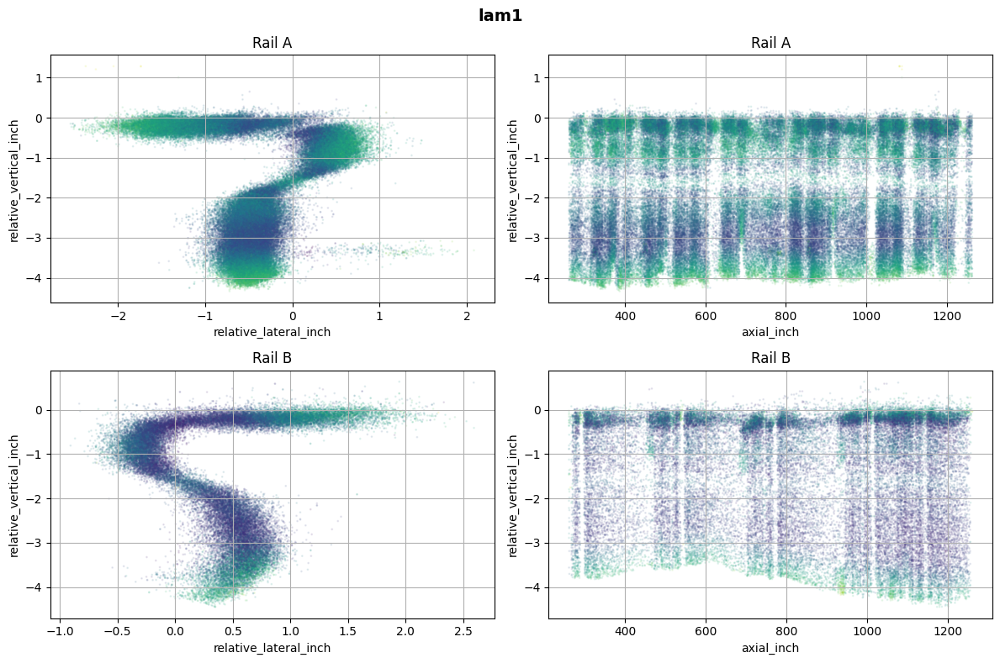

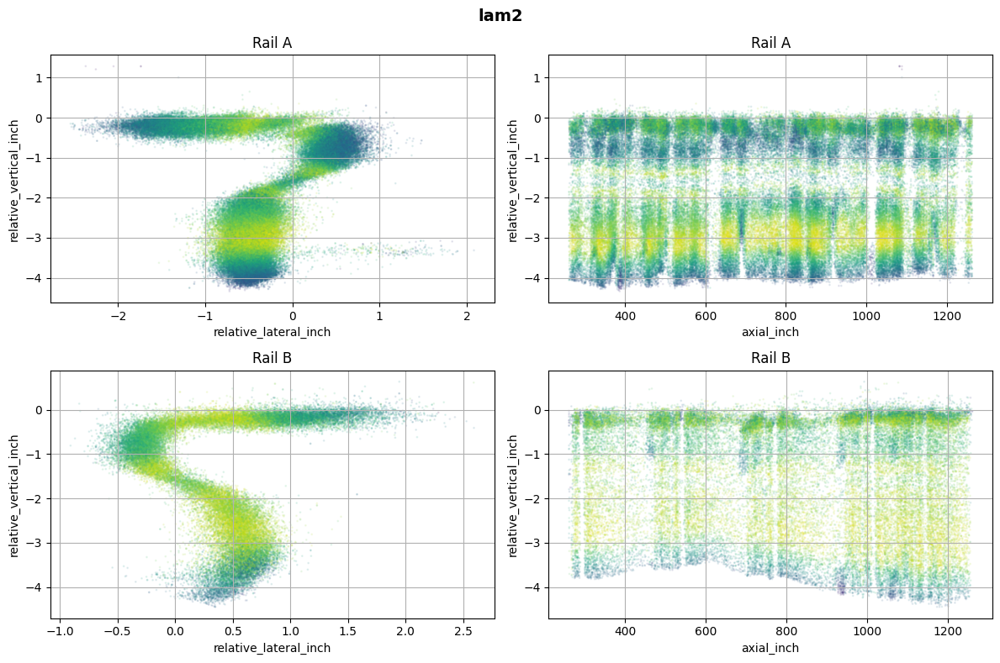

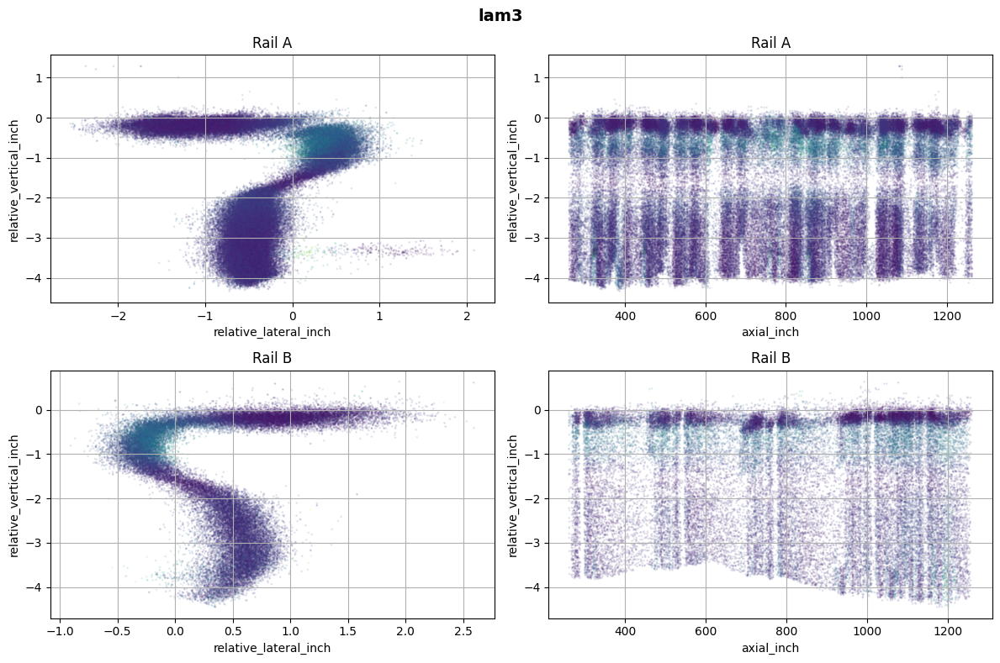

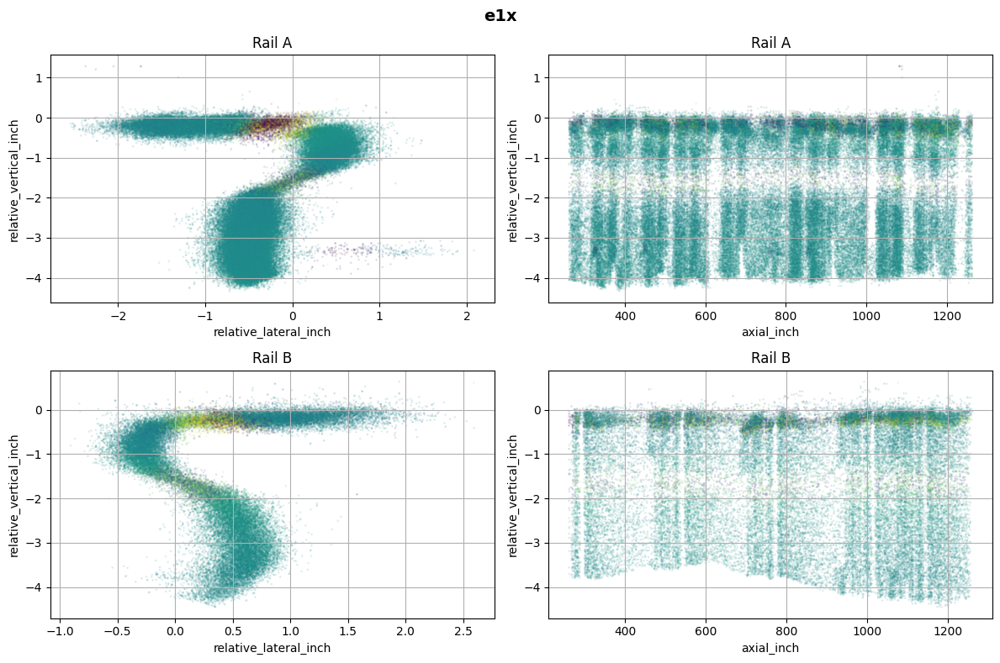

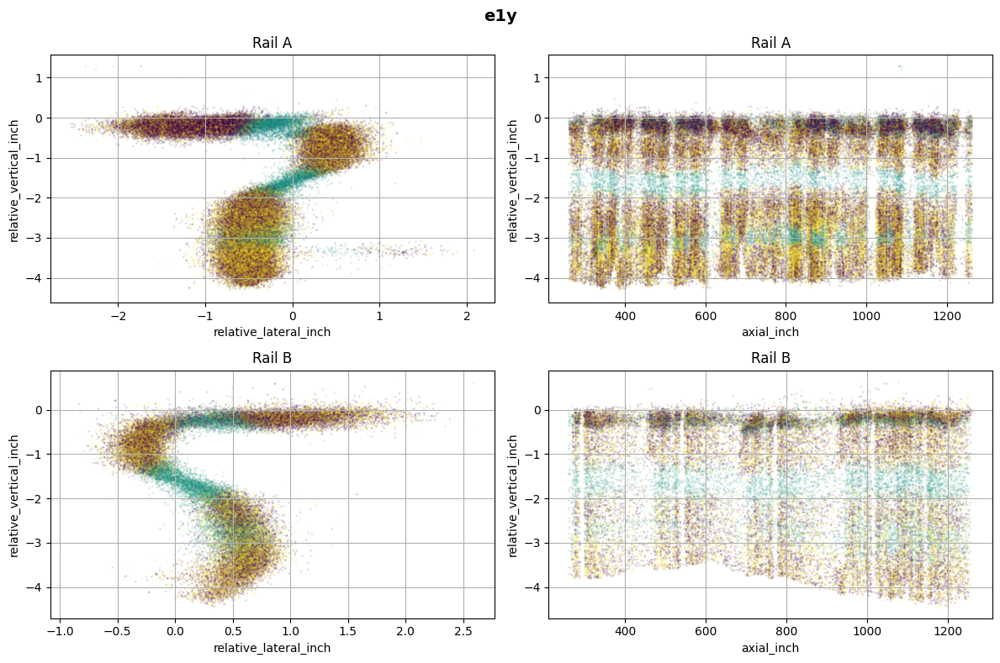

...

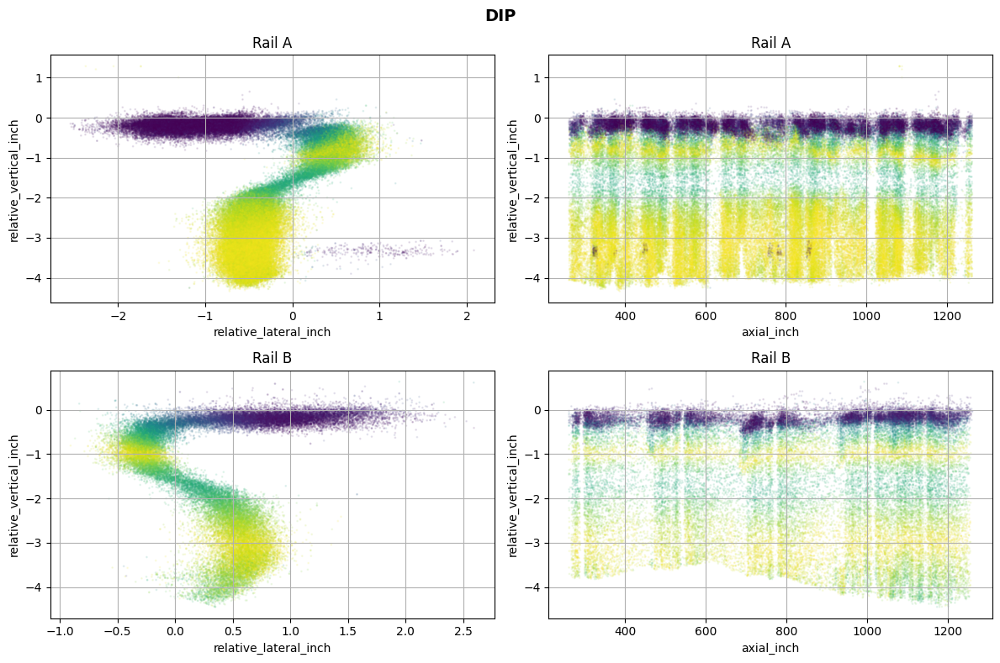

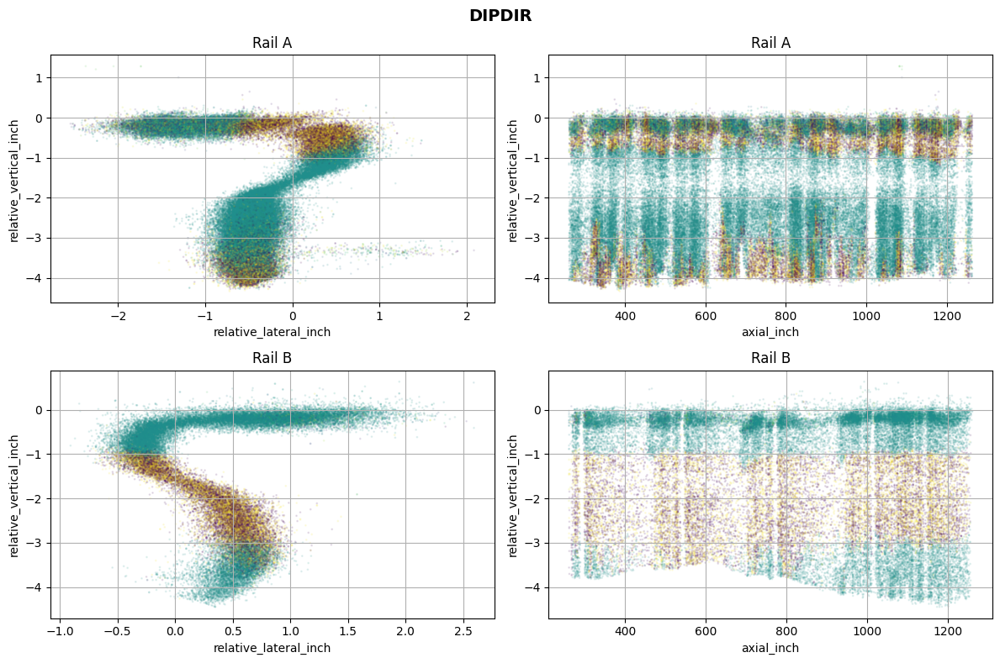

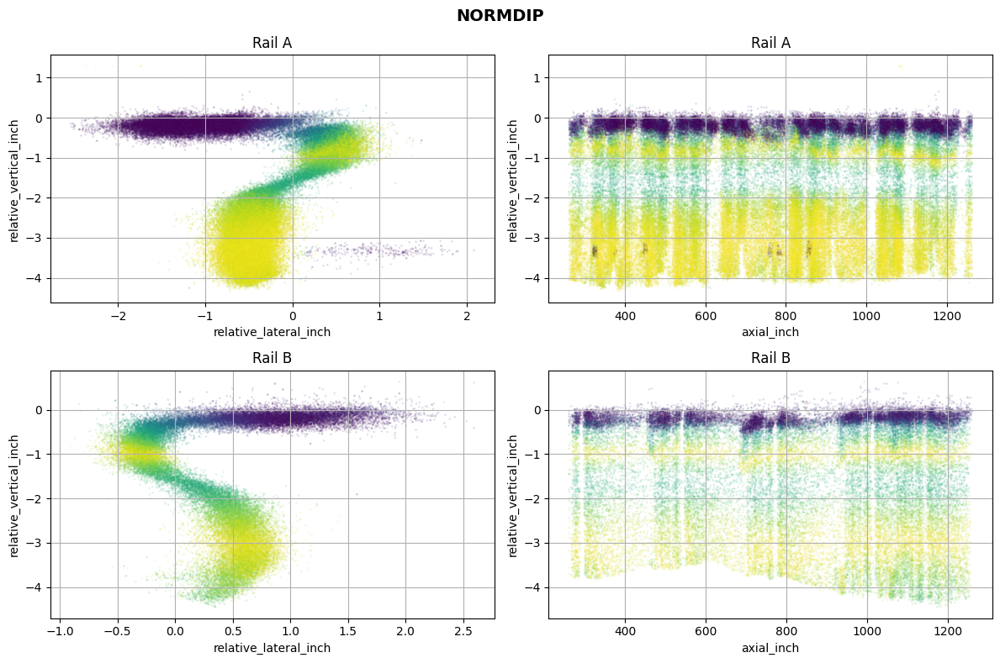

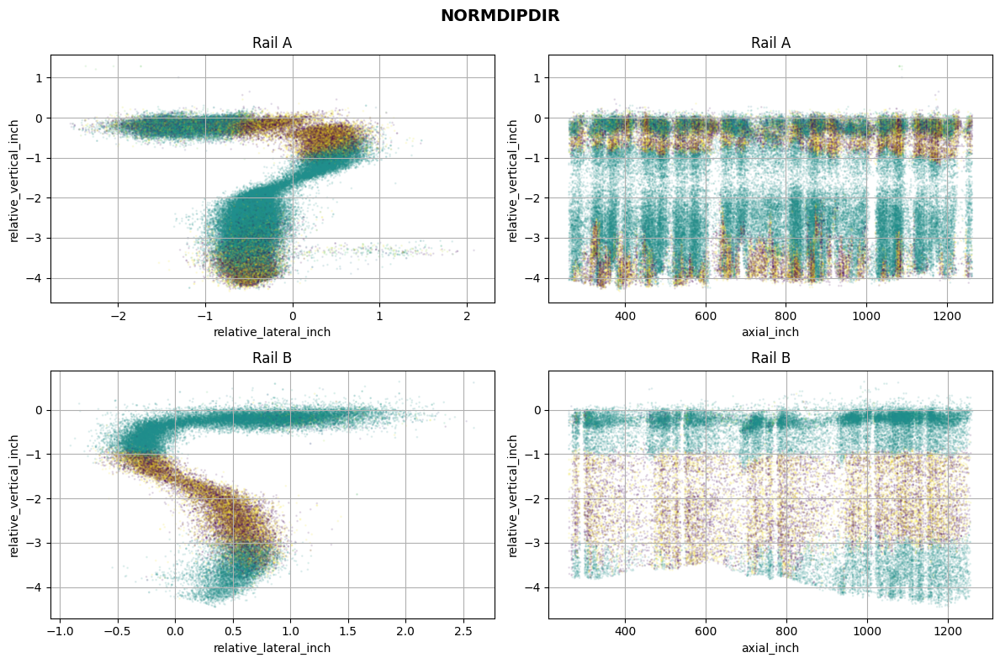

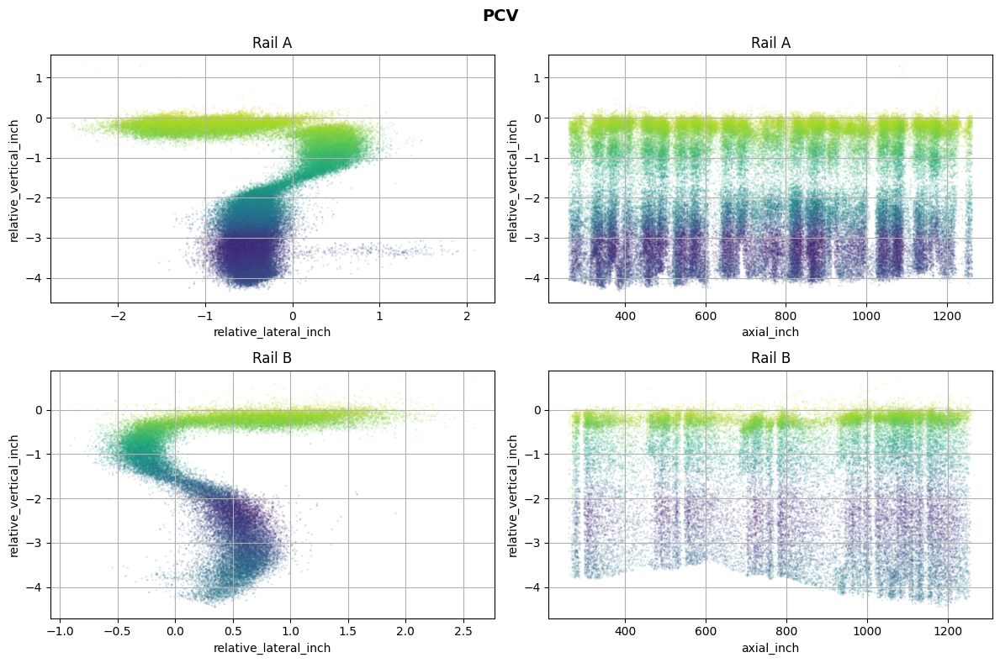

In [13]:
cols = ['lam1', 'lam2', 'lam3', 'e1x', 'e1y', 'e1z', 'e2x', 'e2y', 'e2z', 'e3x',
       'e3y', 'e3z', 'eigen_sum', 'omnivariance', 'eigenentropy', 'anisotropy',
       'planarity', 'linearity', 'surface_variation', 'sphericity', 'pca1',
       'pca2', 'verticality', 'O', 'neighbors', 'Nx', 'Ny', 'Nz',
       'curvature', 'roughness_mean_abs', 'roughness_rms', 'roughness_std',
       'DIP', 'DIPDIR', 'NORMDIP', 'NORMDIPDIR', 'PCV']

for col in cols:
    rail_profiles_scatter_plot(df, title= col, x1='relative_lateral_inch', y1='relative_vertical_inch', x2='axial_inch', y2='relative_vertical_inch', c=col, sample_frac=0.2,)

#### Those plots gave a good visual representation of how each feature can help identify the rail components.

In [14]:
df

,Intensity,Original_cloud_index,PCV,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,...,Ny,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR
0,4,0,0.648305,30.969601,73.969852,0.207422,371.635216,887.638218,2.489062,371.6250,...,0.062184,0.544033,0.026852,0.586352,0.763714,0.489336,57.041393,4.250163,57.041393,4.250163
1,8,0,0.533898,30.971278,72.980139,0.114840,371.655341,875.761669,1.378078,371.6250,...,0.015927,0.029213,0.029050,0.342968,0.450792,0.292552,88.326002,0.912970,88.326002,0.912970
2,6,0,0.504237,30.984129,73.394396,0.174534,371.809543,880.732753,2.094413,371.8125,...,-0.042170,0.401104,0.037013,0.423342,0.594943,0.418018,66.352817,357.361410,66.352817,357.361410
3,11,0,0.572034,30.983353,73.987505,0.076702,371.800232,887.850054,0.920427,371.8125,...,-0.016482,0.018640,0.038069,0.345585,0.441538,0.274822,88.931959,359.055419,88.931959,359.055419
4,12,0,0.885593,30.902538,73.039362,0.325916,370.830450,876.472344,3.910989,370.8125,...,0.004648,0.324284,0.056048,0.600351,0.658095,0.269569,71.077777,179.718462,71.077777,179.718462
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
769209,3,2,0.889831,-44.816390,101.593367,0.526926,-537.796676,1225.120403,6.323110,-537.8125,...,0.007294,0.999547,0.033191,0.795750,1.023313,0.643391,1.723925,14.031263,1.723925,14.031263
769210,7,2,0.957627,-44.818952,102.850671,0.520461,-537.827426,1240.208056,6.245534,-537.8125,...,0.001010,0.995692,0.029967,1.041416,1.207343,0.610844,5.320115,0.624385,5.320115,0.624385
769211,8,2,0.906780,-44.825701,101.852361,0.523527,-537.908414,1228.228330,6.282330,-537.9375,...,-0.006441,0.998819,0.041959,0.552618,0.784714,0.557126,2.784536,352.381014,2.784536,352.381014
769212,1,2,0.911017,-44.799569,101.856541,0.520309,-537.594827,1228.278491,6.243713,-537.6250,...,0.002888,0.993586,0.039341,0.540698,0.778335,0.559868,6.492930,1.463521,6.492930,1.463521


In [15]:
df.describe()

,Intensity,Original_cloud_index,PCV,lateral,axial,vertical,lateral_inch,axial_inch,vertical_inch,lateral_inch_round,...,Ny,Nz,curvature,roughness_mean_abs,roughness_rms,roughness_std,DIP,DIPDIR,NORMDIP,NORMDIPDIR
count,769214.000000,769214.000000,769214.000000,769214.000000,769214.000000,769214.000000,769214.000000,769214.000000,769214.000000,769214.000000,...,769200.000000,7.692000e+05,7.692000e+05,769200.000000,769200.000000,769200.000000,769200.000000,769200.000000,769200.000000,769200.000000
mean,8.069250,0.271833,0.701806,-22.089924,63.743903,0.357714,-265.079090,767.926837,4.292572,-265.079169,...,-0.000073,4.182169e-01,5.331704e-02,0.674388,0.805232,0.426024,58.500563,177.276430,58.500563,177.276430
std,6.295072,0.616582,0.175893,34.682066,23.641162,0.130723,416.184793,283.709800,1.568671,416.184849,...,0.037715,3.881864e-01,2.516371e-02,0.322945,0.317429,0.092578,33.352092,106.160100,33.352092,106.160100
min,0.000000,0.000000,0.334746,-44.925005,21.685846,0.000000,-539.100056,260.230147,0.000000,-539.125000,...,-0.998447,1.591782e-07,-8.335928e-17,0.059275,0.070849,0.038807,0.007300,0.000001,0.007300,0.000001
25%,3.000000,0.000000,0.525424,-44.766897,42.756992,0.266867,-537.202770,516.712691,3.202405,-537.187500,...,-0.020205,6.846965e-02,3.572918e-02,0.414562,0.553548,0.360071,19.974198,172.695903,19.974198,172.695903
50%,7.000000,0.000000,0.694915,-44.735565,65.090824,0.345267,-536.826782,784.424033,4.143208,-536.812500,...,-0.000139,2.547133e-01,4.738657e-02,0.526195,0.654225,0.398957,75.243402,180.019105,75.243402,180.019105
75%,12.000000,0.000000,0.885593,30.935863,86.049213,0.488327,371.230355,1035.545778,5.859929,371.250000,...,0.019874,9.398465e-01,6.432653e-02,0.978913,1.107412,0.506191,86.073906,185.368720,86.073906,185.368720
max,72.000000,2.000000,1.000000,31.178737,104.792800,0.654076,374.144844,1263.513605,7.848909,374.125000,...,0.998856,1.000000e+00,3.106782e-01,2.938672,3.380332,1.709728,89.999991,359.999965,89.999991,359.999965


In [16]:
nan_counts_all = df.isna().sum()
nan_counts_all

Intensity                      0
Original_cloud_index           0
PCV                            0
lateral                        0
axial                          0
vertical                       0
lateral_inch                   0
axial_inch                     0
vertical_inch                  0
lateral_inch_round             0
axial_inch_round               0
vertical_inch_round            0
is_rail_a                      0
is_rail_b                      0
relative_vertical_inch         0
relative_lateral_inch          0
is_synth                  384607
lam1                          14
lam2                          14
lam3                          14
e1x                           14
e1y                           14
e1z                           14
e2x                           14
e2y                           14
e2z                           14
e3x                           14
e3y                           14
e3z                           14
eigen_sum                     14
omnivarian

In [17]:
df = df.dropna(subset=[col for col in df.columns if col != 'is_synth'])

#### Data has all features added and is ready for classification.

In [18]:
df.to_csv('data/df_featured.csv', index=False)